In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
import os
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras import layers
# Input data files are available in the read-only "../input/" directory
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Introduction 

## Problem

This notebook is meant to build a model to transfer photos to Monet style paintings with generative adversial network(GAN). 

GAN architecture is an approach to training a model for image synthesis that is comprised of two models: a generator model and a discriminator model. The generator is responsible for generating plausible images from the dataset whereas the discriminator wants to classify if an image is a real image or a fake(generated) image. Clearly, this is a zero-sum game, which means how much one model gain is how much another model loss. Eventually, we hope our generator will generate high quality images that the discriminator can no longer pick up fake images from true images.

For this particular task, we hope our GAN generator will generate photos that are very "Monet-ish", and our GAN discriminator can also do a good job on identifying Monet style.

## Data

Our data contains real Monet painting with dimension(300, 256, 256, 3) and photoes need to be convert to Monet style with dimension(7028, 256, 256, 3). In other words, we have 300 painting and 7028 photoes, each image has 3 color channels and size of 256 pixel * 256 pixel. 

Note, Kaggle provides all images in two formats: jpg and tfrec. In this notebook, I will use tfrec format as this is a brand new format for me, and I can play with it.

# Exploratory Data Analysis (EDA)

## Load Data

In [2]:
in_dir = '/kaggle/input/gan-getting-started'
out_dir = '/kaggle/working'

monet_tfrec_names = tf.io.gfile.listdir(f'{in_dir}/monet_tfrec')
monet_jpg_names = tf.io.gfile.listdir(f'{in_dir}/monet_jpg')
photo_tfrec_names = tf.io.gfile.listdir(f'{in_dir}/photo_tfrec')
photo_jpg_names = tf.io.gfile.listdir(f'{in_dir}/photo_jpg')

print(f'There are {len(monet_tfrec_names)} Monet TFRecord collections')
print(f'There are {len(monet_jpg_names)} Monet jpgs in total')
print(f'There are {len(photo_tfrec_names)} photo TFRecord collections')
print(f'There are {len(photo_jpg_names):,} photo jpgs in total')
print()
print(f'Sample of what the TFRecord files look like: {monet_tfrec_names}')

There are 5 Monet TFRecord collections
There are 300 Monet jpgs in total
There are 20 photo TFRecord collections
There are 7,038 photo jpgs in total

Sample of what the TFRecord files look like: ['monet12-60.tfrec', 'monet16-60.tfrec', 'monet08-60.tfrec', 'monet04-60.tfrec', 'monet00-60.tfrec']


In [3]:
ex = tf.train.Example()
ex.ParseFromString(
    next(iter(tf.data.TFRecordDataset(f'{in_dir}/monet_tfrec/{monet_tfrec_names[0]}').take(1))).numpy()
)
[k for k in ex.features.feature.keys()]

['image_name', 'target', 'image']

In [4]:
def parse_tfrecord_fn(example):
    # Define the feature description dictionary for decoding
    feature_description = {
        'image': tf.io.FixedLenFeature([], tf.string),  
        'image_name': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.string)
    }
    # Parse the input tf.train.Example proto using the dictionary
    example = tf.io.parse_single_example(example, feature_description)
    
    # Decode the raw bytes into a usable image tensor
    image = tf.image.decode_jpeg(example['image'], channels=3)  # Assume jpg images
    image_name = example['image_name']
    target = example['target']
    
    return image, image_name, target

In [5]:
def load_dataset(tfrec_files):
    raw_dataset = tf.data.TFRecordDataset(tfrec_files)
    parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
    return parsed_dataset

In [6]:
monet_dataset = load_dataset([f'{in_dir}/monet_tfrec/{name}' for name in monet_tfrec_names])
photo_dataset = load_dataset([f'{in_dir}/photo_tfrec/{name}' for name in photo_tfrec_names])

In [7]:
for image, image_name, target in monet_dataset.take(5):
    print(f"Image Name: {image_name.numpy().decode('utf-8')}")
    print(f"Target: {target.numpy().decode('utf-8')}")
    print(f"Image Shape: {image.shape}")

Image Name: b256e61a5d
Target: monet
Image Shape: (256, 256, 3)
Image Name: 49337b68f4
Target: monet
Image Shape: (256, 256, 3)
Image Name: 92c0ba8c0d
Target: monet
Image Shape: (256, 256, 3)
Image Name: f0d789c4bc
Target: monet
Image Shape: (256, 256, 3)
Image Name: b44f24c048
Target: monet
Image Shape: (256, 256, 3)


In [10]:
for image, image_name, target in photo_dataset.take(5):
    print(f"Image Name: {image_name.numpy().decode('utf-8')}")
    print(f"Target: {target.numpy().decode('utf-8')}")
    print(f"Image Shape: {image.shape}")

Image Name: ef833e60b4
Target: photo
Image Shape: (256, 256, 3)
Image Name: 2a14b928c4
Target: photo
Image Shape: (256, 256, 3)
Image Name: 718b15a998
Target: photo
Image Shape: (256, 256, 3)
Image Name: f270b20be4
Target: photo
Image Shape: (256, 256, 3)
Image Name: 75942c4668
Target: photo
Image Shape: (256, 256, 3)


## Inspect and Explore Data

In [8]:
def display_monet_and_photos(monet_ds, photo_ds, num_images=5):    
    monet_images = monet_ds.take(num_images)
    photo_images = photo_ds.take(num_images)
    
    plt.figure(figsize=(8, num_images * 4))

    for i, ((monet_img, monet_name, monet_target), (photo_img, photo_name, photo_target)) in enumerate(zip(monet_images, photo_images)):
        monet_img = monet_img.numpy()  
        photo_img = photo_img.numpy() 

        plt.subplot(num_images, 2, 2 * i + 1)
        plt.imshow(monet_img)
        plt.title(f"Monet Painting: {monet_name.numpy().decode('utf-8')}")
        plt.axis('off')

        
        plt.subplot(num_images, 2, 2 * i + 2)
        plt.imshow(photo_img)
        plt.title(f"Photo: {photo_name.numpy().decode('utf-8')}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()        
        

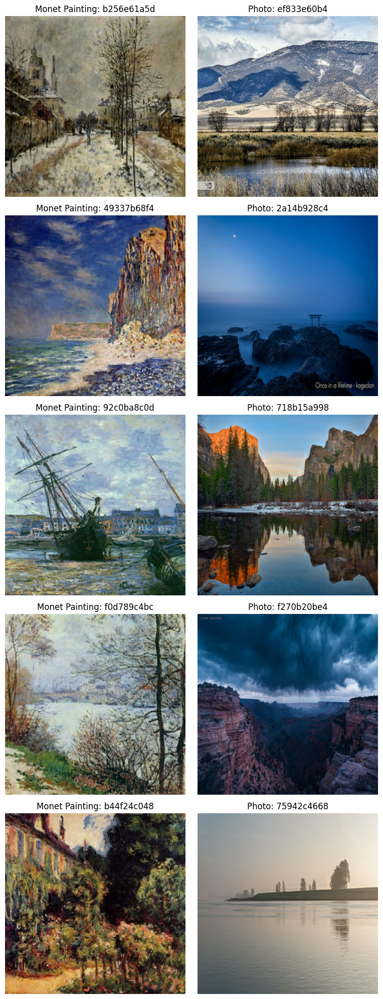

In [9]:
display_monet_and_photos(monet_dataset, photo_dataset)

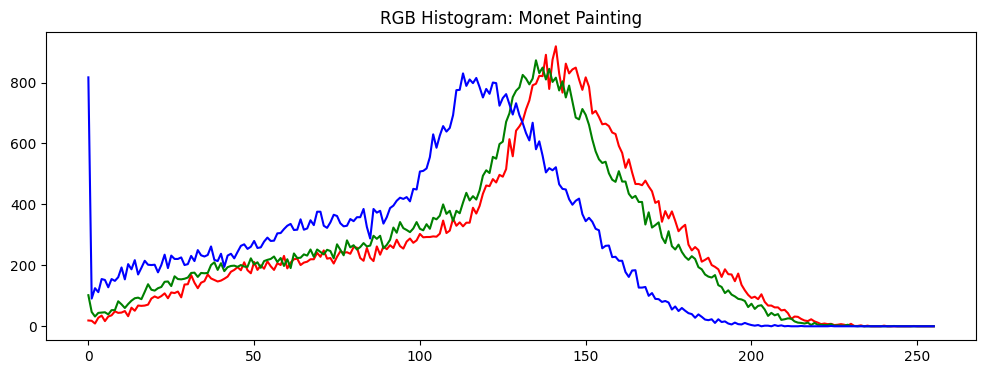

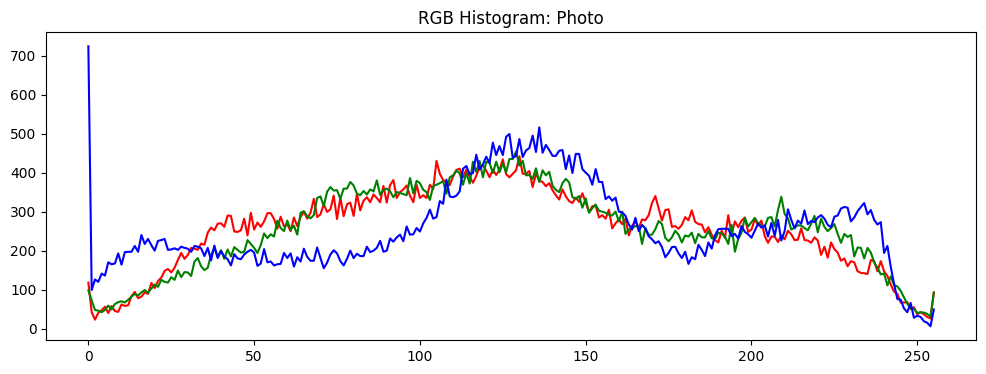

In [24]:
def plot_rgb_histogram(image, title):
    plt.figure(figsize=(12, 4))
    for i, color in enumerate(['red', 'green', 'blue']):
        hist = np.histogram(image[:, :, i], bins=256, range=(0, 255))[0]
        plt.plot(hist, color=color)
    plt.title(f'RGB Histogram: {title}')
    plt.show()

# Get a sample of Monet and photo images and plot histograms
monet_sample_image = next(iter(monet_dataset))[0].numpy()
photo_sample_image = next(iter(photo_dataset))[0].numpy()

plot_rgb_histogram(monet_sample_image, "Monet Painting")
plot_rgb_histogram(photo_sample_image, "Photo")

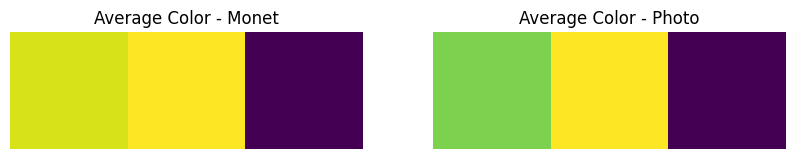

In [26]:
def get_mean_rgb(dataset):
    mean_colors = []
    for img, _, __ in dataset:
        mean_rgb = np.mean(img, axis=(0, 1))  # Average color per channel
        mean_colors.append(mean_rgb)
    return np.array(mean_colors)

# Compute the mean RGB colors for both datasets
monet_mean_colors = get_mean_rgb(monet_dataset)
photo_mean_colors = get_mean_rgb(photo_dataset)

# Plot the mean colors
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow([monet_mean_colors.mean(axis=0) / 255])  
plt.title('Average Color - Monet')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow([photo_mean_colors.mean(axis=0) / 255]) 
plt.title('Average Color - Photo')
plt.axis('off')

plt.show()

The colors among Monet painting and real photos are quiet similar, except Monet's style is slightly warmer.

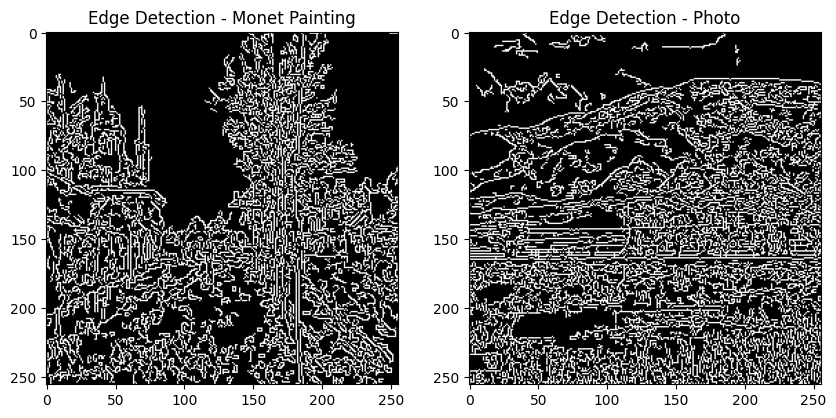

In [28]:
def detect_edges(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray_image, threshold1=100, threshold2=200)
    return edges

# Get edge-detected images
monet_edges = detect_edges(monet_sample_image)
photo_edges = detect_edges(photo_sample_image)

# Plot edge detection results
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(monet_edges, cmap='gray')
plt.title('Edge Detection - Monet Painting')

plt.subplot(1, 2, 2)
plt.imshow(photo_edges, cmap='gray')
plt.title('Edge Detection - Photo')

plt.show()

Interestingly, the real photos seem to have more horizontal edges while Monet prefered to have more vertical edges.

# Model Architecture

## Prepare Data

In [29]:
monet_images = monet_dataset.map(lambda image, image_name, target: (tf.cast(image, tf.float32) / 255.0)).batch(1)
photo_images = photo_dataset.map(lambda image, image_name, target: (tf.cast(image, tf.float32) / 255.0)).batch(1)

## Cycle GAN Model

To do: explaination to cycle gan

In [30]:
def residual_block(x, filters, kernel_size=(3, 3)):
    """Defines a residual block with two convolutional layers."""
    shortcut = x
    x = layers.Conv2D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    return layers.add([shortcut, x])


In [31]:
def build_generator(input_shape):
    inputs = layers.Input(shape=input_shape)
    
    # Initial Conv block
    x = layers.Conv2D(64, (7, 7), padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    # Downsampling 
    x = layers.Conv2D(128, (3, 3), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    for _ in range(4):
        x = residual_block(x, 128)

    # Upsampling
    x = layers.Conv2DTranspose(64, (3, 3), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # Output layer (Tanh for normalized pixel values)
    x = layers.Conv2D(3, (7, 7), padding='same')(x)
    outputs = layers.Activation('tanh')(x)

    return tf.keras.Model(inputs, outputs)

In [32]:
def build_discriminator(input_shape):
    inputs = layers.Input(shape=input_shape)

    x = layers.Conv2D(64, (4, 4), strides=2, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(128, (4, 4), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(256, (4, 4), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(512, (4, 4), strides=1, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(1, (4, 4), strides=1, padding='same')(x)
    return tf.keras.Model(inputs, x)

In [33]:
image_shape = (256, 256, 3) 

In [34]:
G = build_generator(image_shape)  # Photo → Monet
F = build_generator(image_shape)  # Monet → Photo

D_X = build_discriminator(image_shape)  # Discriminator for Monet images
D_Y = build_discriminator(image_shape) # Discriminator for Photo images

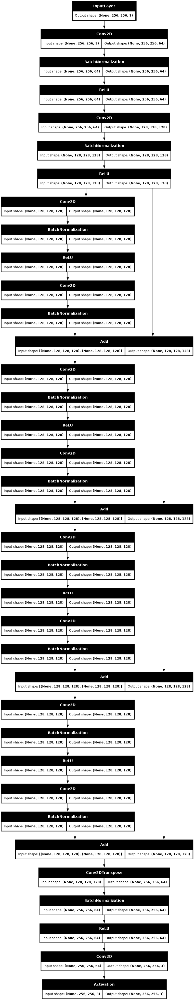

In [35]:
tf.keras.utils.plot_model(G, show_shapes=True, dpi=64)

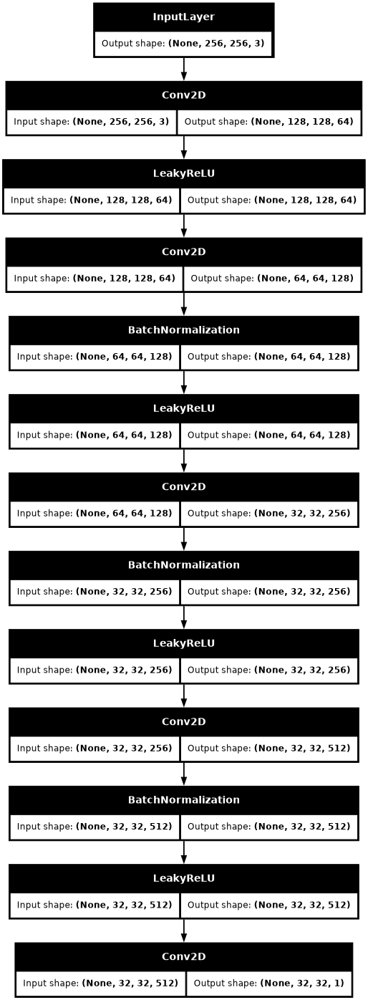

In [36]:
tf.keras.utils.plot_model(D_X, show_shapes=True, dpi=64)

In [37]:
mse = tf.keras.losses.MeanSquaredError()

def adversarial_loss(y_real, y_fake):
    return mse(tf.ones_like(y_real), y_fake)

def cycle_consistency_loss(real_image, cycled_image, lambda_cycle):
    loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return lambda_cycle * loss

def identity_loss(real_image, same_image, lambda_identity):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return lambda_identity * loss

In [38]:
g_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
f_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
d_x_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
d_y_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

In [43]:
@tf.function
def train_step(real_photo, real_monet, G, F, D_X, D_Y, 
               lambda_cycle=10, lambda_identity=5):
    
    # GradientTape for updating both generators
    with tf.GradientTape(persistent=True) as tape:
        
        # Generate fake Monet image (Photo → Monet) and reconstruct back (Monet → Photo)
        fake_monet = G(real_photo, training=True)
        cycled_photo = F(fake_monet, training=True)
        
        # Generate fake Photo image (Monet → Photo) and reconstruct back (Photo → Monet)
        fake_photo = F(real_monet, training=True)
        cycled_monet = G(fake_photo, training=True)       

        # Identity Mapping
        same_monet = G(real_monet, training=True)
        same_photo = F(real_photo, training=True)
        
        # Discriminator prediction for real and fake images
        disc_real_monet = D_X(real_monet, training=True)
        disc_fake_monet = D_X(fake_monet, training=True)
        
        disc_real_photo = D_Y(real_photo, training=True)
        disc_fake_photo = D_Y(fake_photo, training=True)
        
        # ===== Losses =====
        
        # Generator adversarial loss (G: Photo → Monet, F: Monet → Photo)
        gen_g_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        gen_f_loss = adversarial_loss(disc_real_photo, disc_fake_photo)
        
        # Cycle consistency loss
        cycle_loss_g = cycle_consistency_loss(real_photo, cycled_photo, lambda_cycle)
        cycle_loss_f = cycle_consistency_loss(real_monet, cycled_monet, lambda_cycle)
        
        # Identity loss 
        id_loss_g = identity_loss(real_monet, same_monet, lambda_identity)
        id_loss_f = identity_loss(real_photo, same_photo, lambda_identity)
        
        # Total generator loss
        total_loss_g = gen_g_loss + cycle_loss_g + id_loss_g
        total_loss_f = gen_f_loss + cycle_loss_f + id_loss_f

        # Discriminator loss for Monet (D_X) and Photos (D_Y)
        disc_x_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        disc_y_loss = adversarial_loss(disc_real_photo, disc_fake_photo)
    
    # ====== Compute Gradients ======
    # Gradients for generators
    grad_g = tape.gradient(total_loss_g, G.trainable_variables)
    grad_f = tape.gradient(total_loss_f, F.trainable_variables)
    
    # Gradients for discriminators
    grad_d_x = tape.gradient(disc_x_loss, D_X.trainable_variables)
    grad_d_y = tape.gradient(disc_y_loss, D_Y.trainable_variables)
    
    # ====== Apply Gradients ======
    g_optimizer.apply_gradients(zip(grad_g, G.trainable_variables))
    f_optimizer.apply_gradients(zip(grad_f, F.trainable_variables))
    
    d_x_optimizer.apply_gradients(zip(grad_d_x, D_X.trainable_variables))
    d_y_optimizer.apply_gradients(zip(grad_d_y, D_Y.trainable_variables))
    
    return {
        "gen_g_loss": total_loss_g,
        "gen_f_loss": total_loss_f,
        "disc_x_loss": disc_x_loss,
        "disc_y_loss": disc_y_loss
    }


In [46]:
def generate_and_save_images(G, F, monet_sample, photo_sample, epoch, save_dir='tmp/generated_images/'):
    # Generate Monet-style image from a photo using G
    generated_monet = G(photo_sample, training=False)    
    # Generate Photo-style image from a Monet painting using F
    generated_photo = F(monet_sample, training=False)    
    
    plt.figure(figsize=(10, 10))
    
    plt.subplot(2, 2, 1)
    plt.title("Original Photo")
    plt.imshow(photo_sample[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.title("Generated Monet Style (G)")
    plt.imshow(generated_monet[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
    plt.axis('off')
    
    plt.subplot(2, 2, 3)
    plt.title("Original Monet Painting")
    plt.imshow(monet_sample[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
    plt.axis('off')
    
    plt.subplot(2, 2, 4)
    plt.title("Generated Photo Style (F)")
    plt.imshow(generated_photo[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
    plt.axis('off')
    
    # Save the plot to a file
    # plt.savefig(f"{save_dir}epoch_{epoch}.png")
    plt.show()


In [44]:
import time
def train_cycle_gan(G, F, D_X, D_Y, monet_images, photo_images, epochs=100):
    
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        time0 = time.time()
        # Iterate over batches of Monet and Photo datasets
        for real_monet, real_photo in tf.data.Dataset.zip((monet_images, photo_images)):            
            # Run one training step
            losses = train_step(real_photo, real_monet, G, F, D_X, D_Y)            
            
        time1 = time.time()
        print(f"Epoch {epoch + 1} takes {time1 - time0} s")        
        monet_sample = next(iter(monet_images.take(1)))
        photo_sample = next(iter(photo_images.take(1)))
        monet_sample = (monet_sample - 0.5) * 2  # Normalize to [-1, 1]
        photo_sample = (photo_sample - 0.5) * 2  # Normalize to [-1, 1]
        generate_and_save_images(G, F, monet_sample, photo_sample, epoch)


Epoch 1/20
Epoch 1 takes 96.69574642181396 s


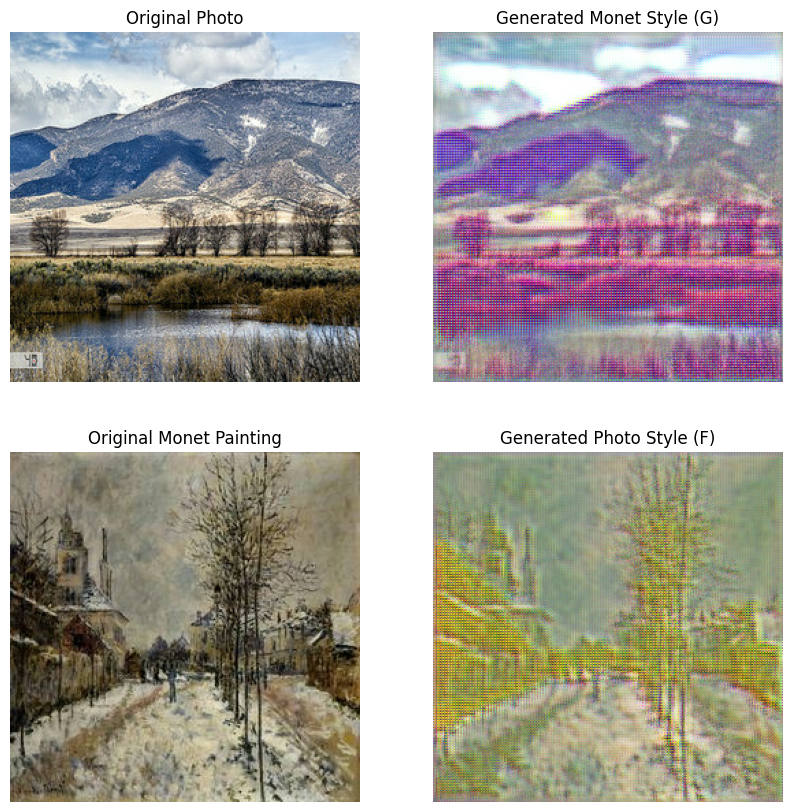

Epoch 2/20
Epoch 2 takes 70.23166990280151 s


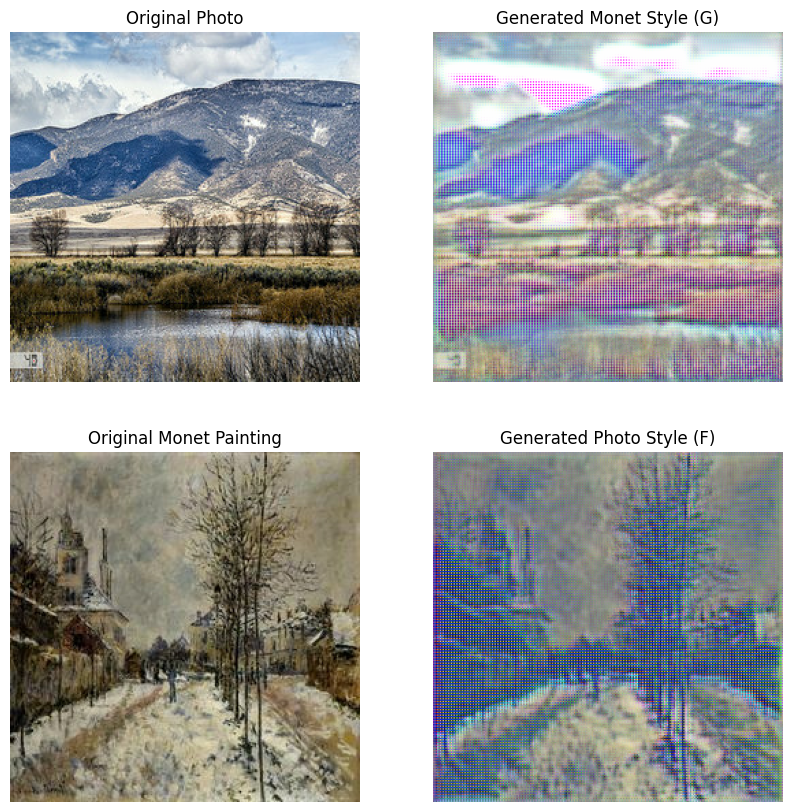

Epoch 3/20
Epoch 3 takes 70.18280363082886 s


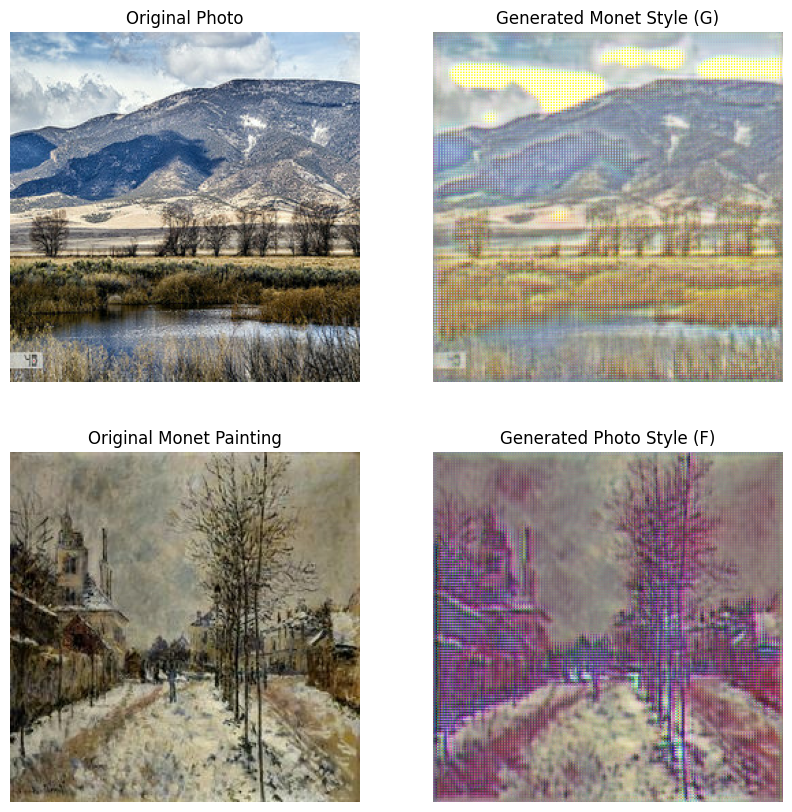

Epoch 4/20
Epoch 4 takes 70.17272901535034 s


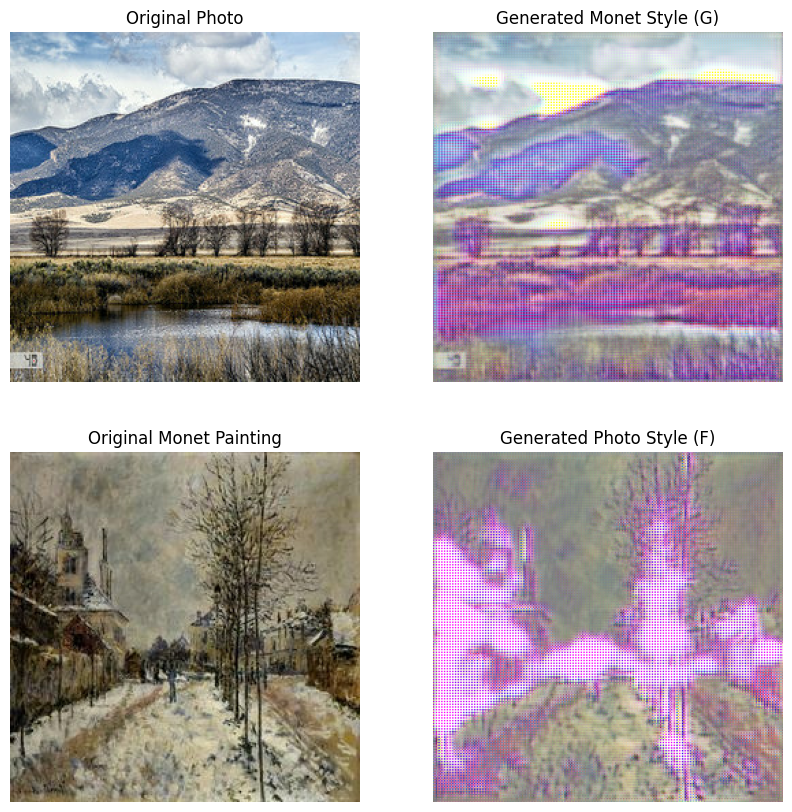

Epoch 5/20
Epoch 5 takes 70.14989423751831 s


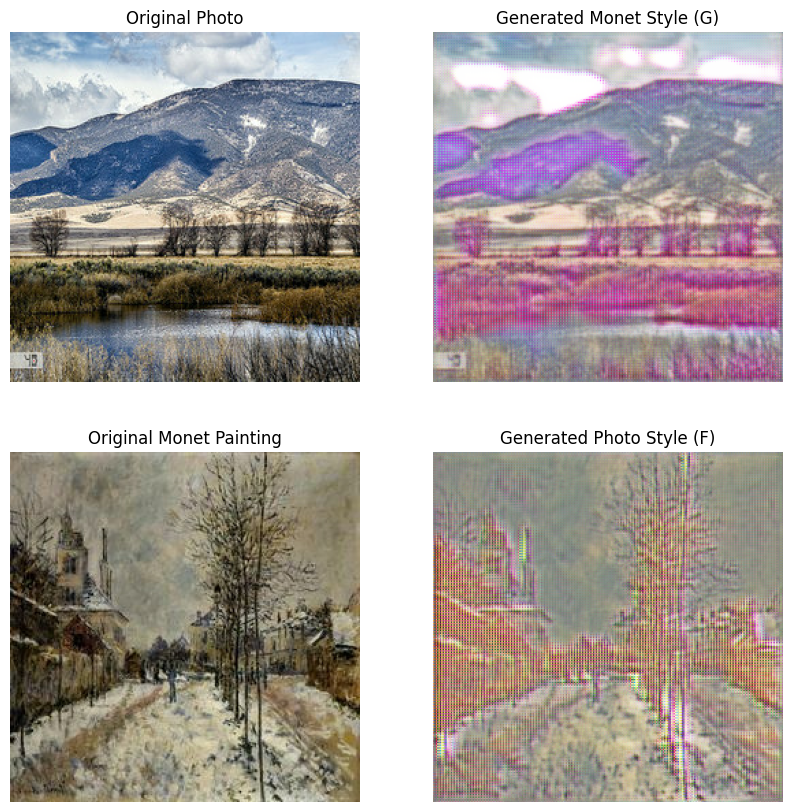

Epoch 6/20
Epoch 6 takes 70.1593222618103 s


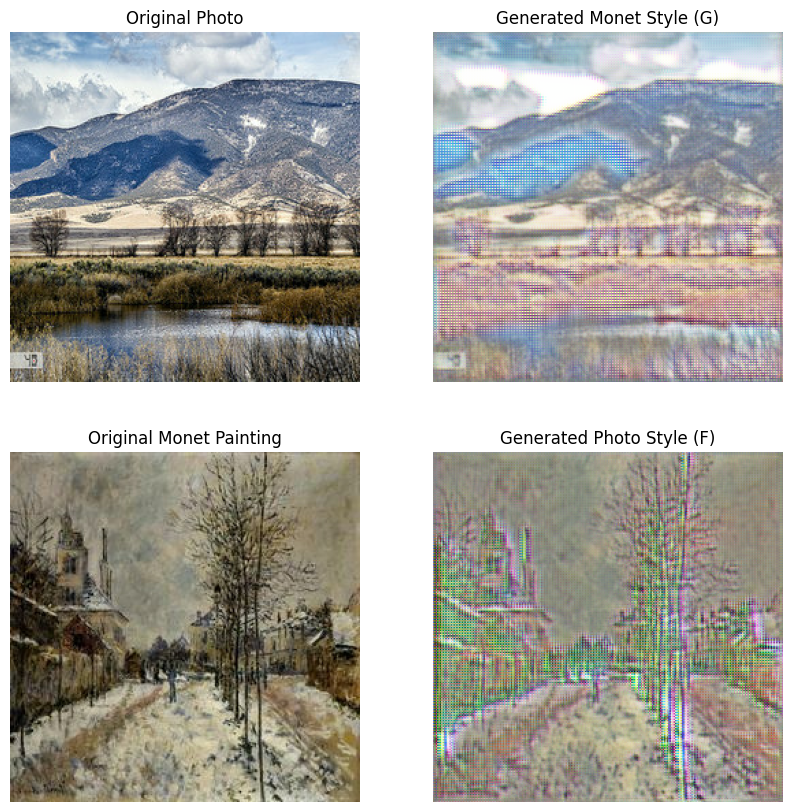

Epoch 7/20
Epoch 7 takes 70.15521502494812 s


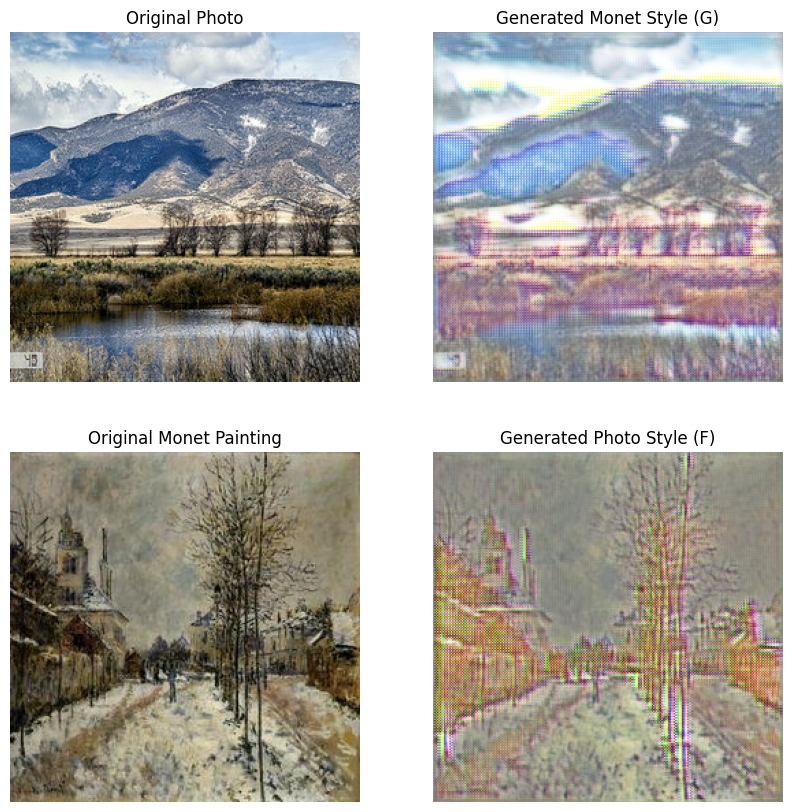

Epoch 8/20
Epoch 8 takes 70.16499471664429 s


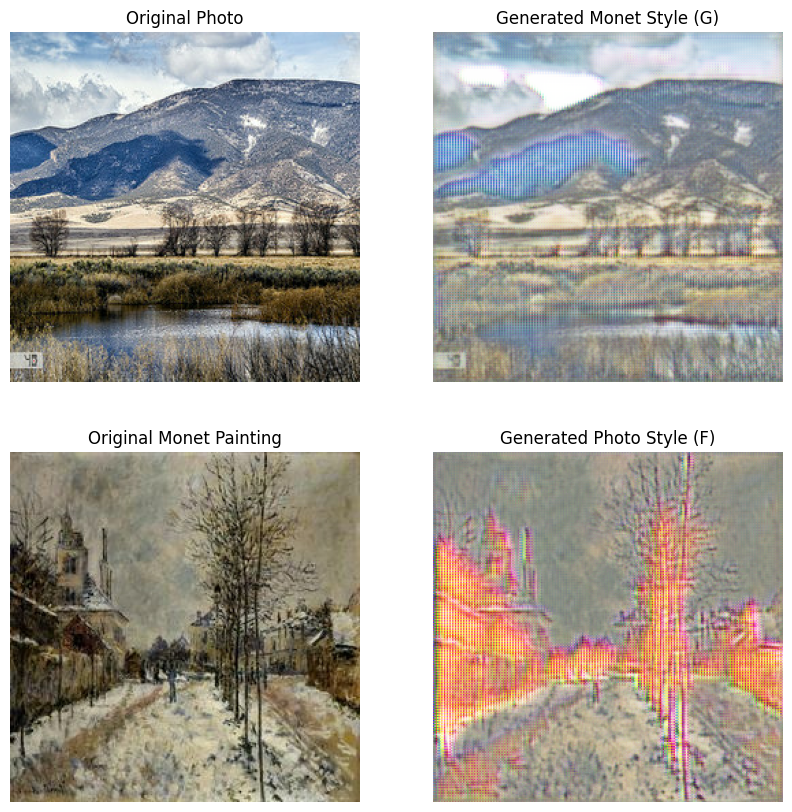

Epoch 9/20
Epoch 9 takes 70.20383882522583 s


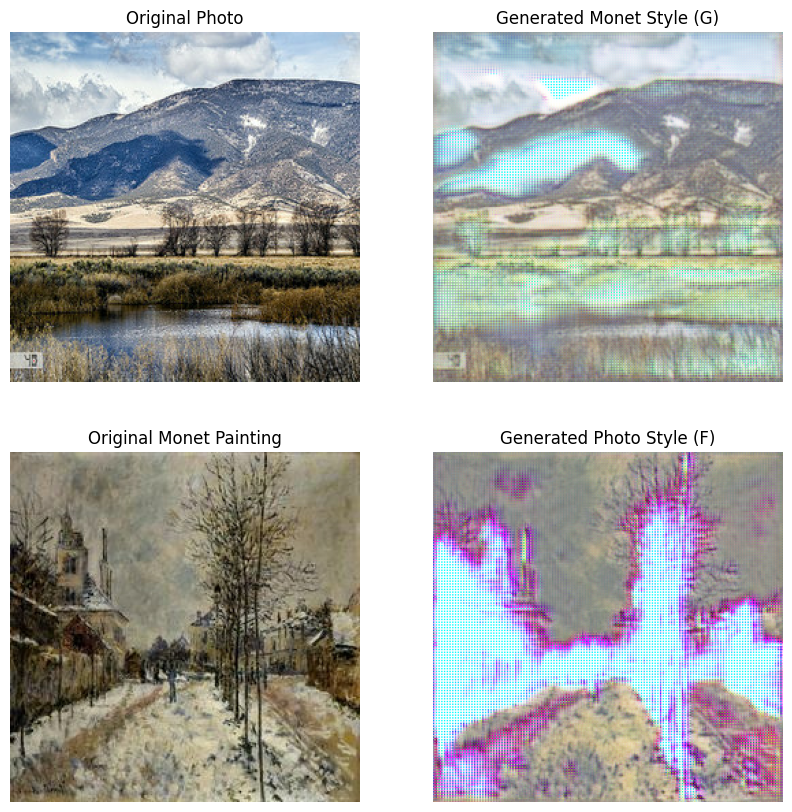

Epoch 10/20
Epoch 10 takes 70.20072531700134 s


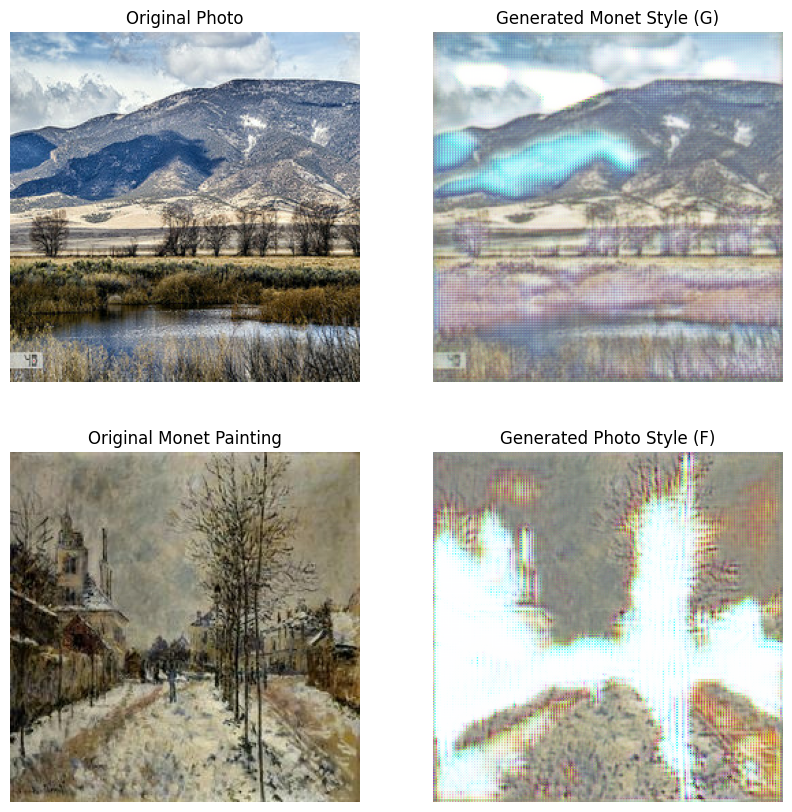

Epoch 11/20
Epoch 11 takes 70.20204591751099 s


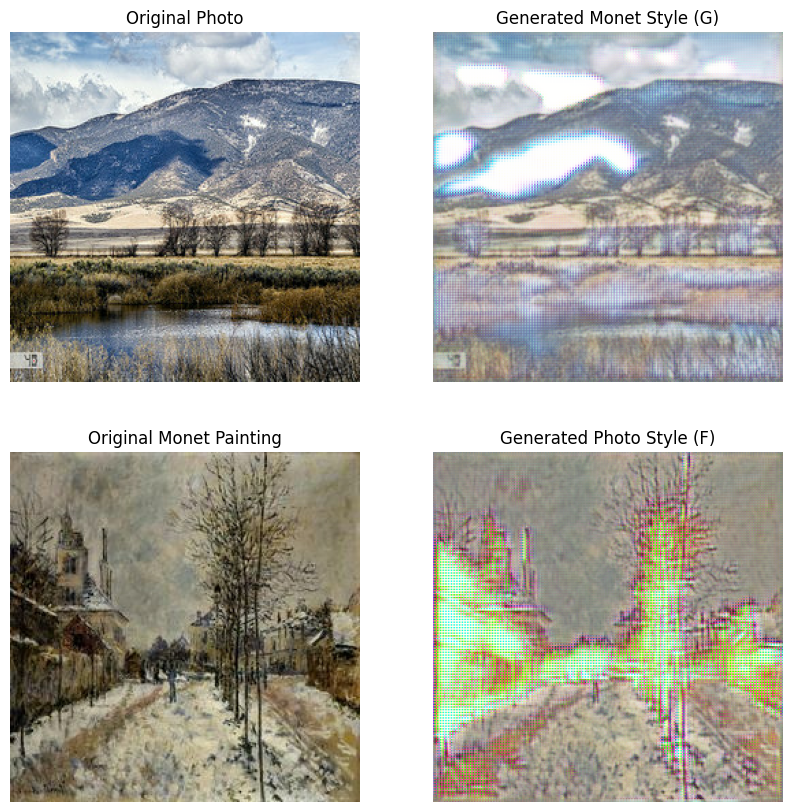

Epoch 12/20
Epoch 12 takes 70.17487168312073 s


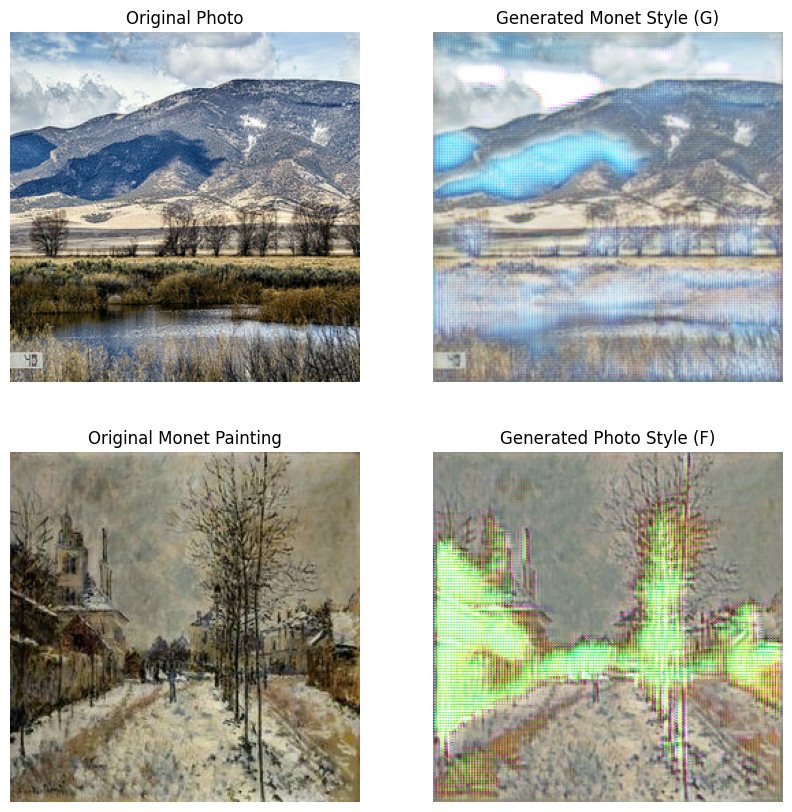

Epoch 13/20
Epoch 13 takes 81.95149970054626 s


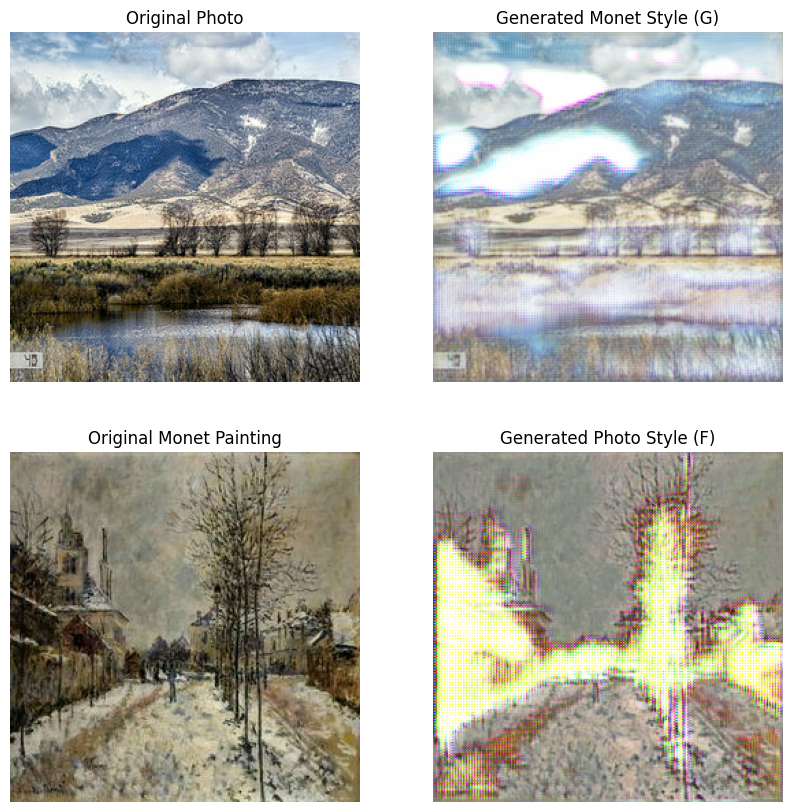

Epoch 14/20
Epoch 14 takes 70.17701721191406 s


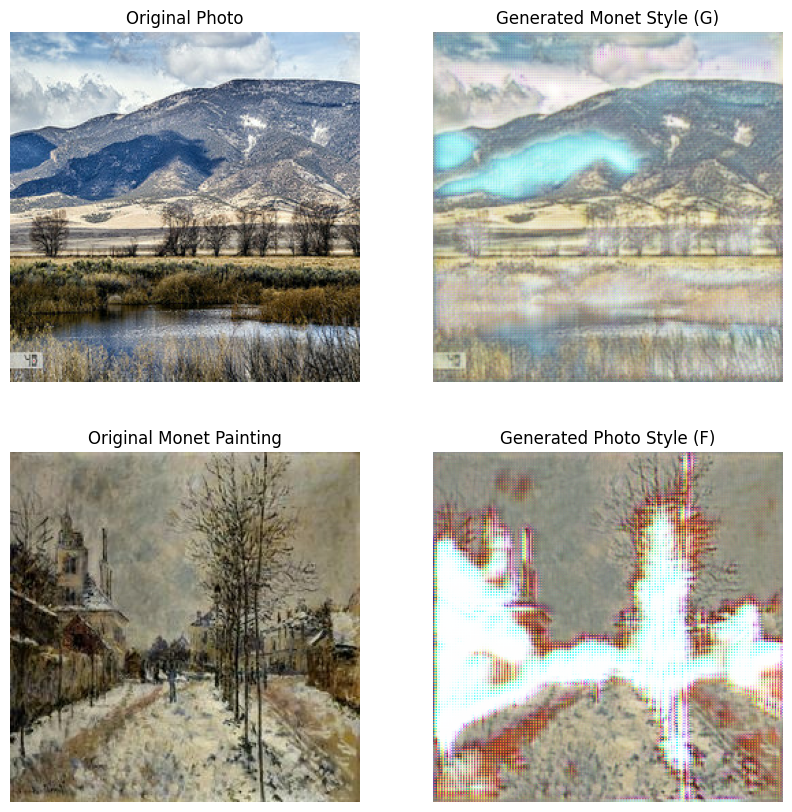

Epoch 15/20
Epoch 15 takes 70.16324138641357 s


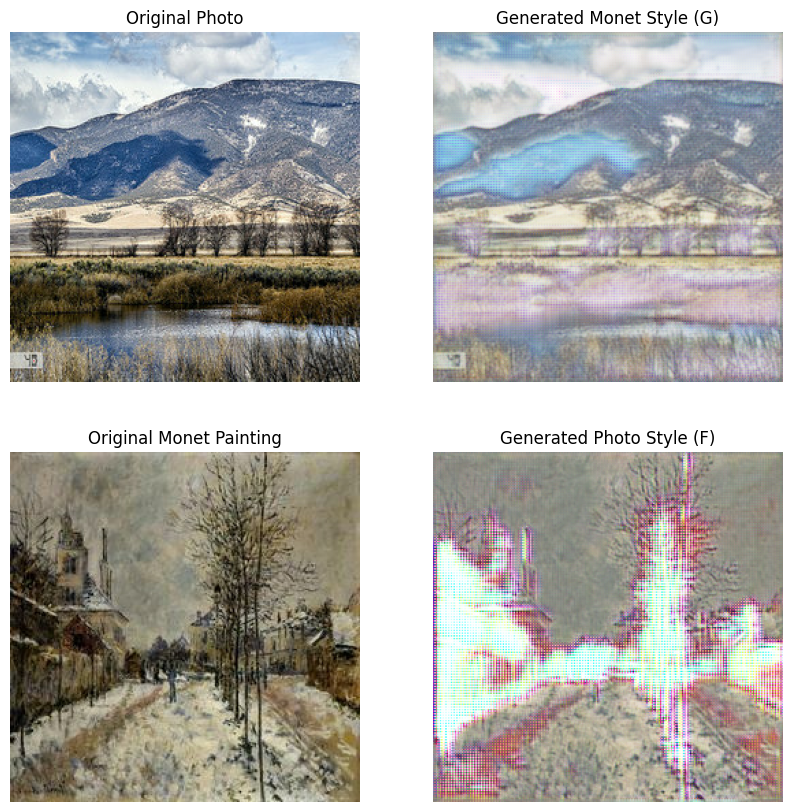

Epoch 16/20
Epoch 16 takes 70.1531229019165 s


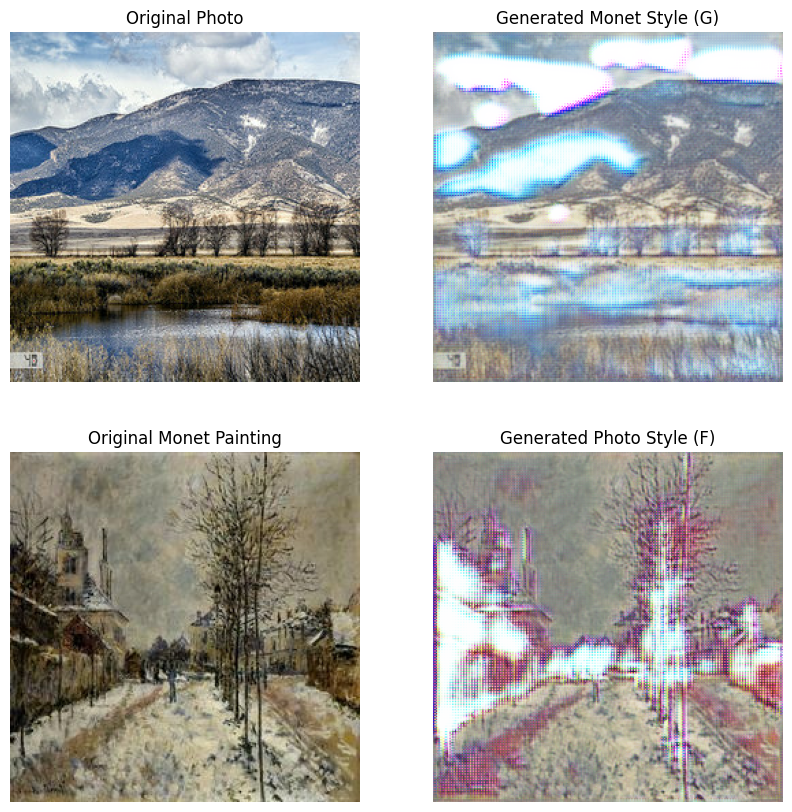

Epoch 17/20
Epoch 17 takes 70.17990446090698 s


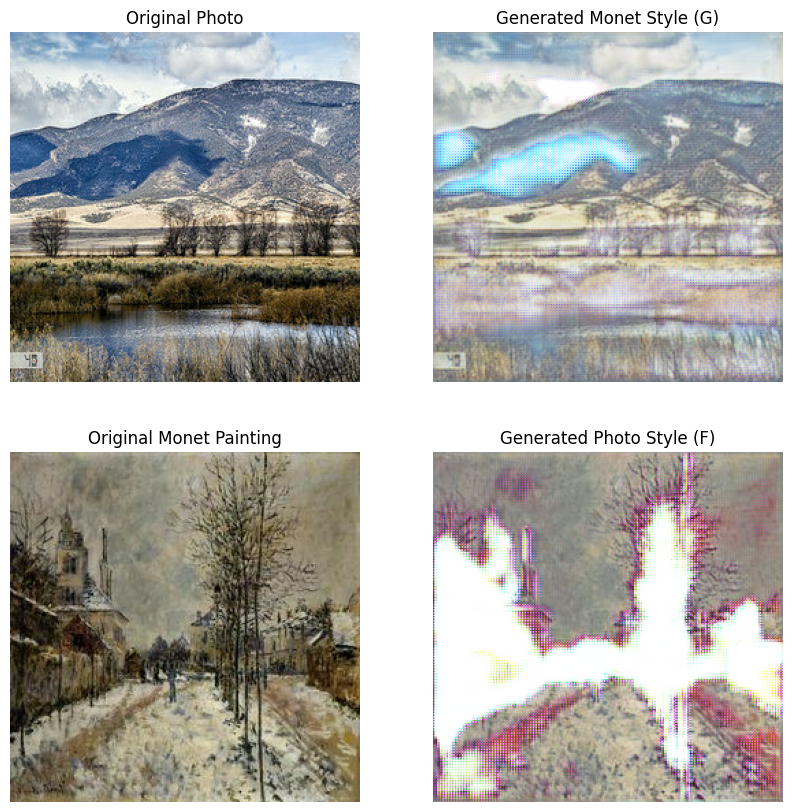

Epoch 18/20
Epoch 18 takes 70.16550517082214 s


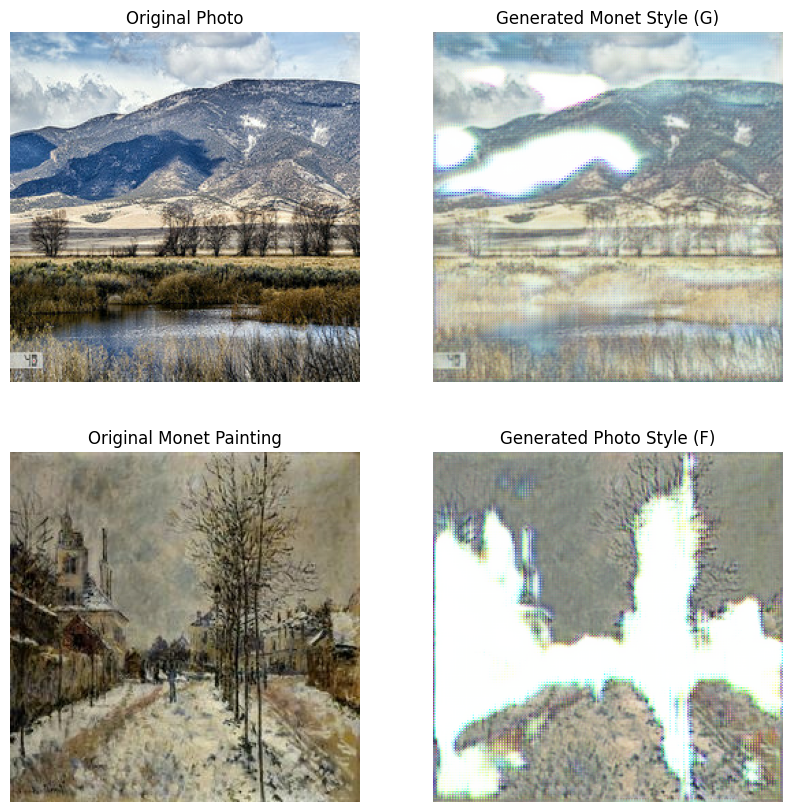

Epoch 19/20
Epoch 19 takes 70.13959813117981 s


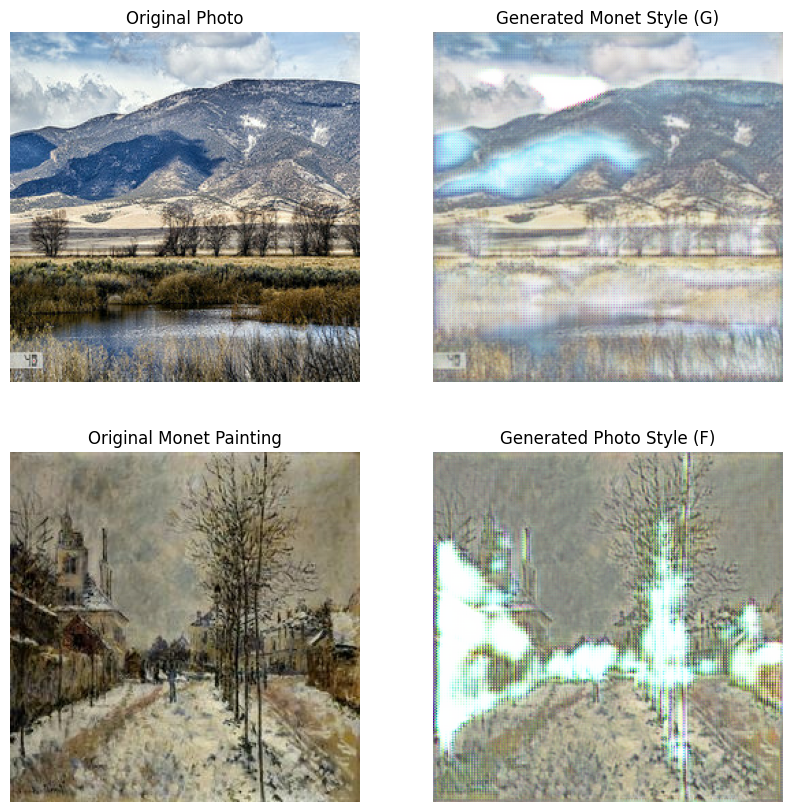

Epoch 20/20
Epoch 20 takes 70.12610602378845 s


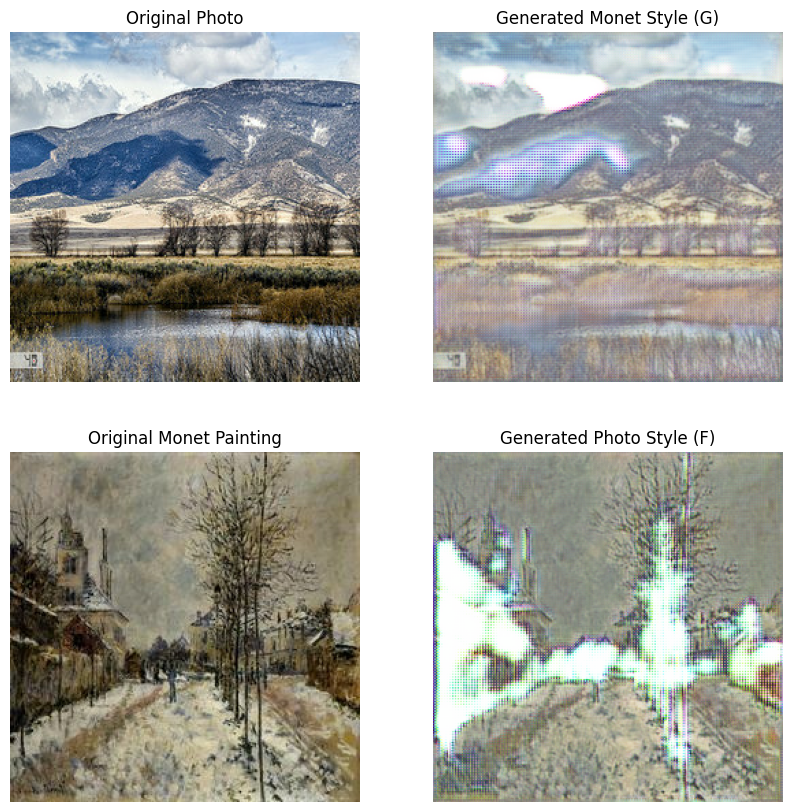

CPU times: user 19min 5s, sys: 9min 36s, total: 28min 42s
Wall time: 24min 17s


In [45]:
%%time
train_cycle_gan(G, F, D_X, D_Y, monet_images, photo_images, epochs=20)

## Hyperparameter Tuning

# Results and Analysis

## Model Results

## Analysis

 # Conclusion

# Reference

* https://blog.keras.io/building-autoencoders-in-keras.html
* https://en.wikipedia.org/wiki/Generative_adversarial_network
* https://github.com/junyanz/CycleGAN
* https://machinelearningmastery.com/what-is-cyclegan/
* https://www.youtube.com/watch?v=4LktBHGCNfw
* **https://www.kaggle.com/code/josephleakakos/mo-monet-mo-problems**